In [2]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -U -r yolov5/requirements.txt  # install dependencies

fatal: destination path 'yolov5' already exists and is not an empty directory.
     |████████████████████████████████| 10.3MB 5.6MB/s 
     |████████████████████████████████| 15.7MB 343kB/s 
     |████████████████████████████████| 49.9MB 104kB/s 
     |████████████████████████████████| 3.0MB 41.7MB/s 
     |████████████████████████████████| 645kB 51.8MB/s 
     |████████████████████████████████| 28.5MB 1.3MB/s 
Requirement already up-to-date: torch>=1.7.0 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 10)) (1.9.0+cu102)
Requirement already up-to-date: torchvision>=0.8.1 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 11)) (0.10.0+cu102)
     |████████████████████████████████| 81kB 11.9MB/s 
Requirement already up-to-date: tensorboard>=2.4.1 in /usr/local/lib/python3.7/dist-packages (from -r yolov5/requirements.txt (line 15)) (2.5.0)
Requirement already up-to-date: seaborn>=0.11.0 in /usr/local/lib/python3.7/dist-package

In [1]:
!pip install torch==1.6.0+cu101 torchvision==0.7.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 708.0MB 24kB/s 
     |████████████████████████████████| 5.9MB 31.8MB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.6.0+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102


In [3]:
cd /content/yolov5

/content/yolov5


In [4]:
import torch
from IPython.display import Image  # for displaying images
from utils.google_utils import gdrive_download  # for downloading models/datasets

print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.6.0+cu101 _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Images

In [ ]:
!unrar 

In [7]:
import os
train_files = os.listdir('/content/drive/MyDrive/yolo_dataset/yolo/train/Images')

In [8]:
test_files = os.listdir('/content/drive/MyDrive/yolo_dataset/yolo/test/Images')

In [10]:
import shutil

In [12]:
for im in os.listdir('/content/train'):
  if '.jpeg' in im:
    shutil.move("/content/train/"+str(im),"/content/train/Images/"+str(im))

In [13]:
for im in train_files:
  if im not in os.listdir('/content/train/Images'):
    shutil.copy("/content/drive/MyDrive/yolo_dataset/yolo/train/Images/"+str(im),"/content/train/Images/"+str(im))

In [14]:
for im in test_files:
  shutil.copy("/content/drive/MyDrive/yolo_dataset/yolo/test/Images/"+str(im),"/content/test/Images/"+str(im))

# labels

In [15]:
train_files_labels = os.listdir('/content/drive/MyDrive/yolo_dataset/yolo/train/Annotations')

In [16]:
for lbl in train_files_labels:
  shutil.copy("/content/drive/MyDrive/yolo_dataset/yolo/train/Annotations/"+str(lbl),"/content/train/labels/"+str(lbl))

In [17]:
test_files_labels = os.listdir('/content/drive/MyDrive/yolo_dataset/yolo/test/Annotations')

In [18]:
for lbl in test_files_labels:
  shutil.copy("/content/drive/MyDrive/yolo_dataset/yolo/test/Annotations/"+str(lbl),"/content/test/labels/"+str(lbl))

In [19]:
pwd

'/content/yolov5'

In [22]:
cd ..

/content


In [23]:
%cat data.yaml

train: ../train/Images
val: ../test/Images

nc: 2
names: ['mask','no mask']

In [24]:
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [25]:
%cat /content/yolov5/models/yolov5s.yaml

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

In [26]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: 2  # number of classes  # CHANGED HERE
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [43]:
import os
os.chdir('/content/yolov5/')

In [47]:
%cd /content/yolov5/
!python train.py --img 416 --batch 80 --epochs 200 --data './data.yaml' --cfg ./models/custom_yolov5s.yaml --weights ''

/content
train: weights=, cfg=./models/custom_yolov5s.yaml, data=./data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=200, batch_size=80, img_size=[416], rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache_images=False, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-290-g62409ee torch 1.9.0+cu102 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, 

In [59]:
# Start tensorboard
# Launch after you have started training to all the graphs needed for inspection
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

<IPython.core.display.Javascript object>

In [51]:
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/exp15/weights/best.pt --img 416 --conf 0.5 --source /content/images/test

/content
detect: weights=['/content/yolov5/runs/train/exp15/weights/best.pt'], source=/content/images/test, imgsz=416, conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 v5.0-290-g62409ee torch 1.9.0+cu102 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 232 layers, 7249215 paramete

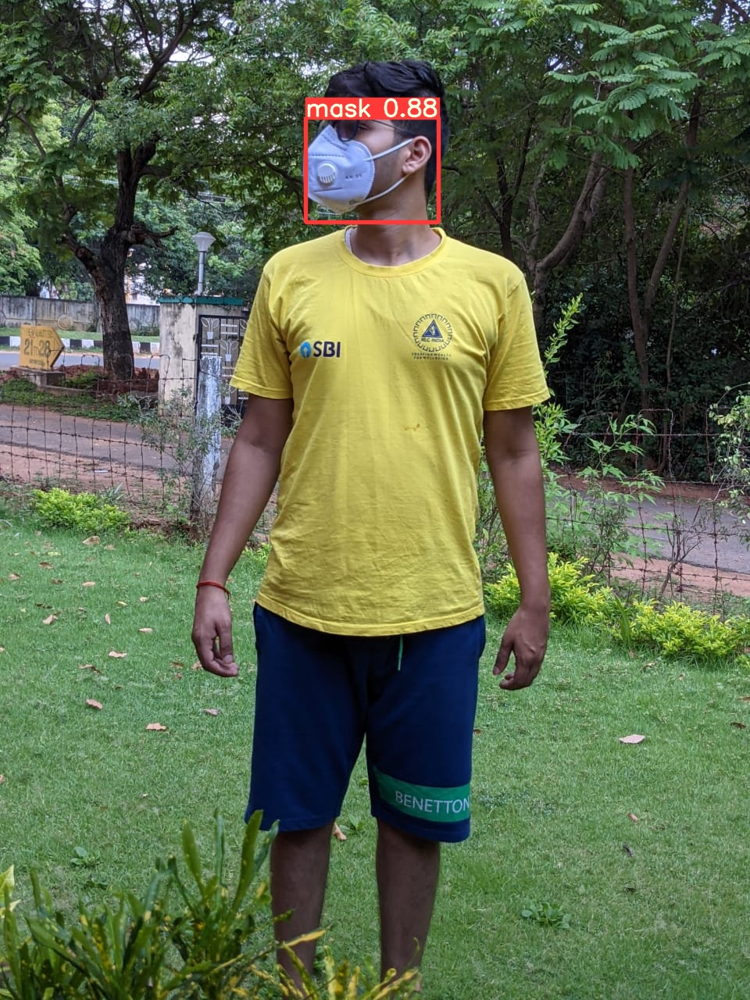

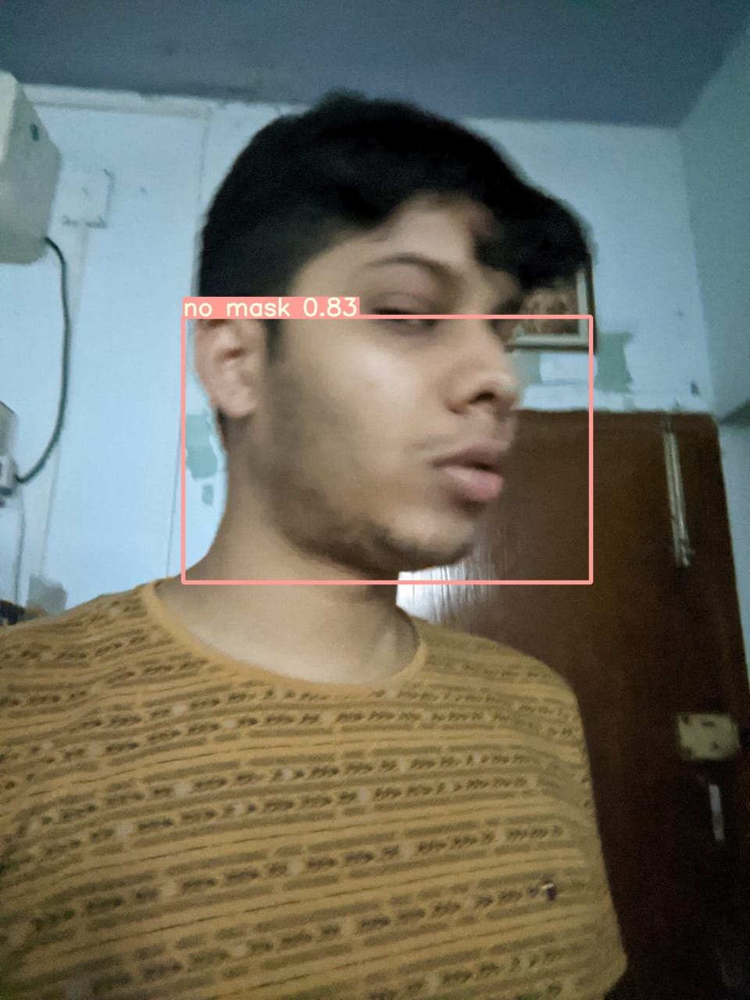

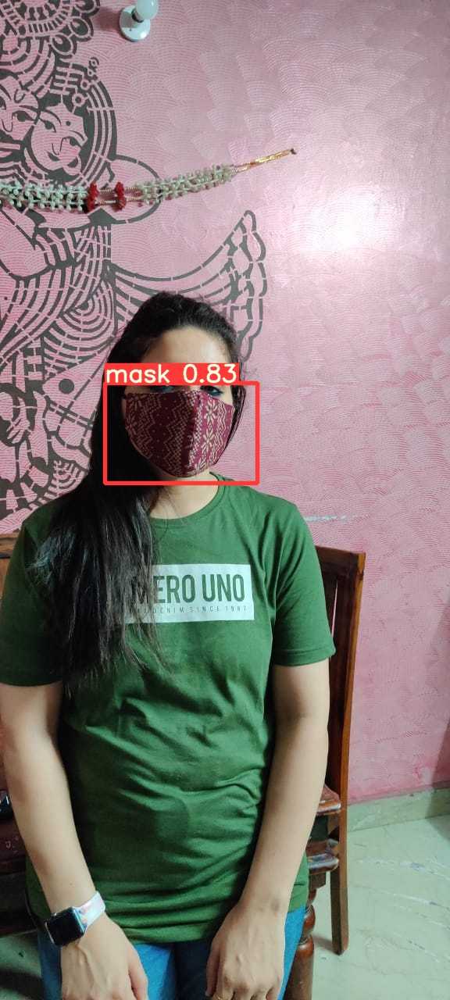

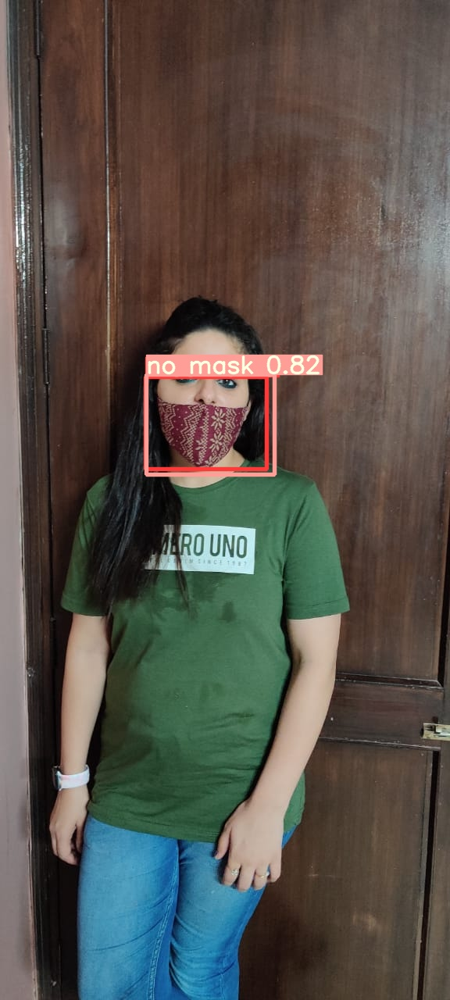

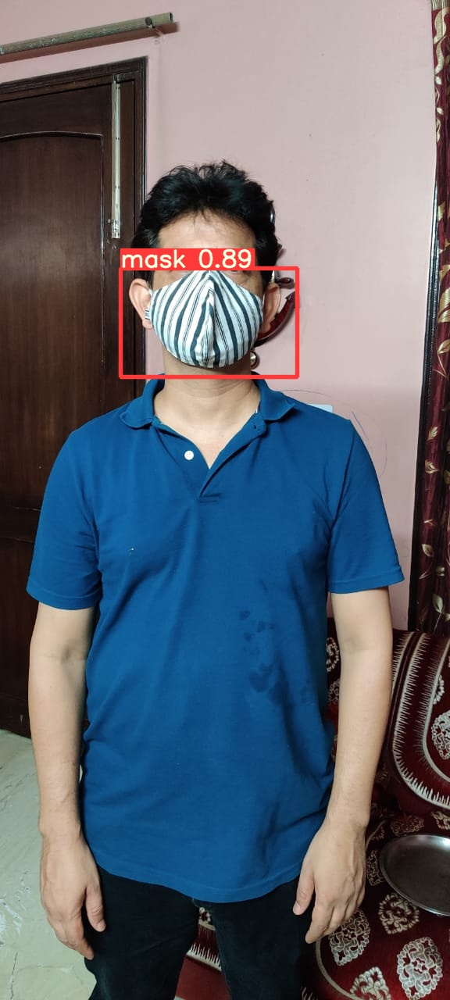

...

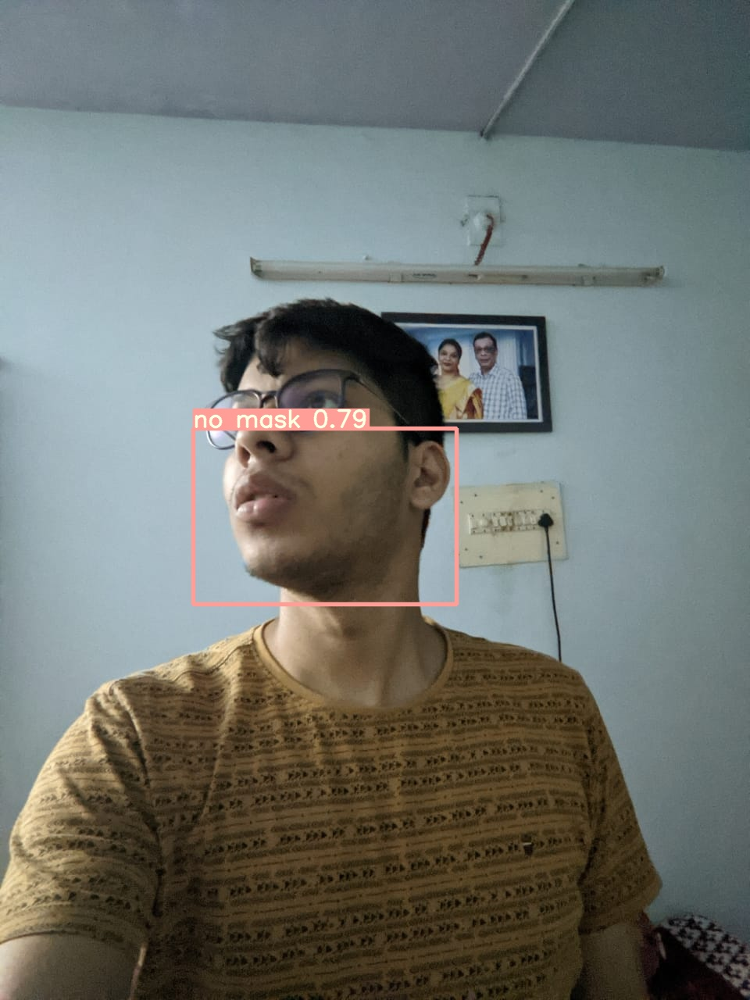

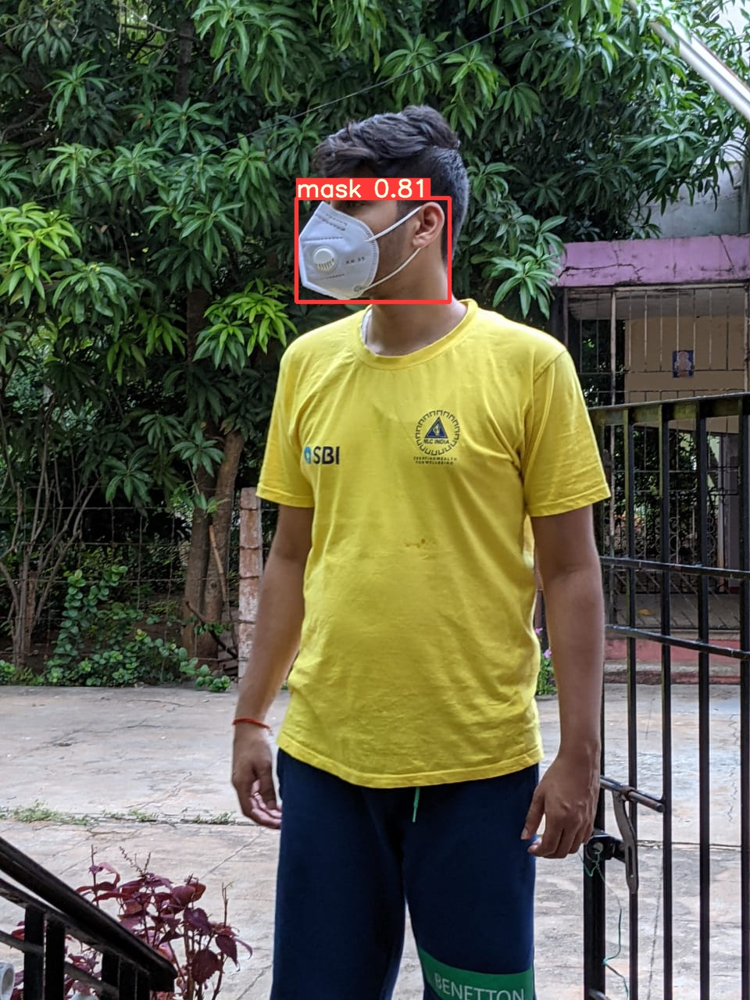

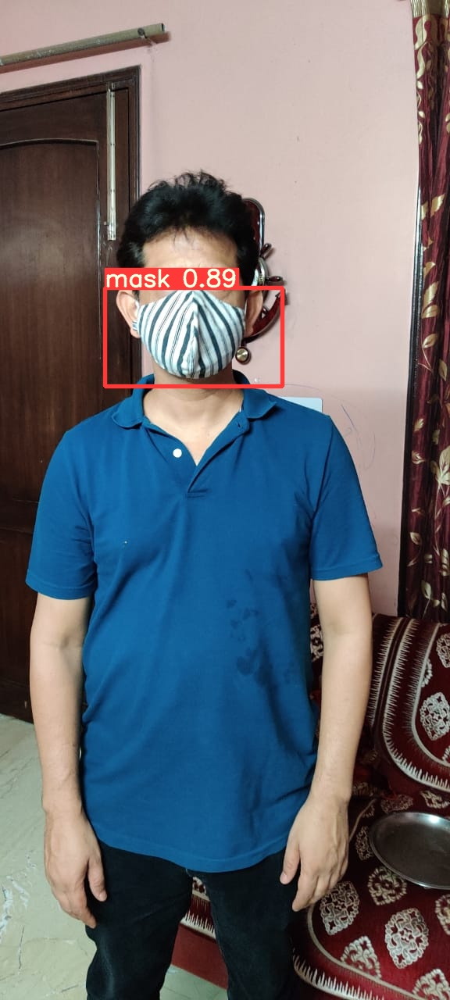

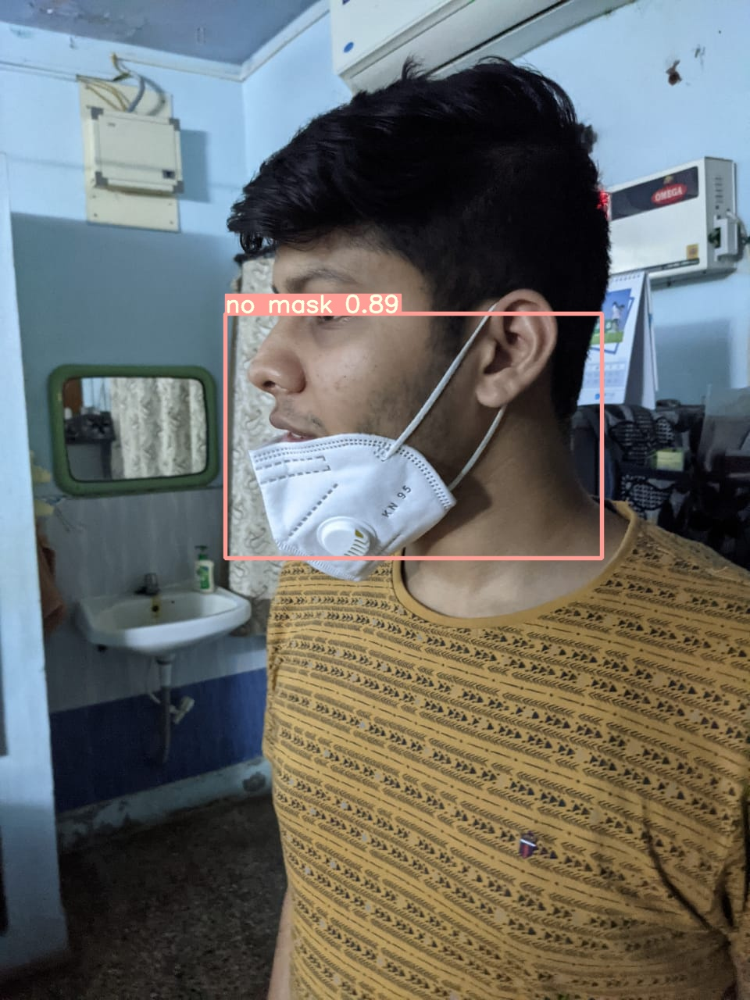

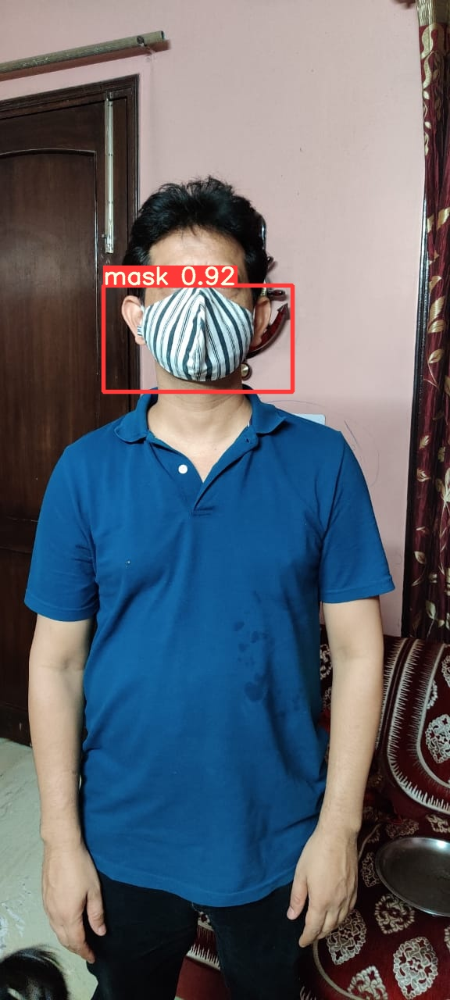

In [52]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpeg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [62]:
%cp /content/yolov5/runs/train/exp15/weights/best.pt /content/drive/MyDrive

In [63]:
%cp /content/yolov5/runs/train/exp15/weights/last.pt /content/drive/MyDrive